# Data Visualization and Domain Understanding


## Directory Analysis

In [1]:
pwd()

'/Users/r/Desktop/Synexian/ML Research Ideas and Topics/Camera Matrix Python/tests/notebooks'

In [2]:
cd /Users/r/Desktop/Synexian/ML Research Ideas and Topics/Camera Matrix Python/

/Users/r/Desktop/Synexian/ML Research Ideas and Topics/Camera Matrix Python


In [3]:
!pip install numpy opencv-python scipy pillow tqdm


In [4]:
DATA_ROOT = "data/sunrgbd"

In [5]:
import os
import cv2
import numpy as np
from PIL import Image
from scipy.io import loadmat

def analyze_sunrgbd_folder(root_dir, sample_limit=3):
    """
    Analyze SUN RGB-D folder structure and data types.
    
    Args:
        root_dir (str): path like data/sunrgbd/kv1/b3dodata
        sample_limit (int): how many img_xxxx folders to sample deeply
    """
    print(f"\n📁 Analyzing dataset at: {root_dir}\n")
    
    img_dirs = sorted([
        d for d in os.listdir(root_dir)
        if d.startswith("img_") and os.path.isdir(os.path.join(root_dir, d))
    ])
    
    print(f"Total image folders found: {len(img_dirs)}")
    print("Sample folders:", img_dirs[:5], "\n")

    modality_summary = {}

    for img_dir in img_dirs[:sample_limit]:
        print(f"\n{'='*60}")
        print(f"🔍 Inspecting {img_dir}")
        print(f"{'='*60}")

        full_path = os.path.join(root_dir, img_dir)
        contents = os.listdir(full_path)

        for item in contents:
            item_path = os.path.join(full_path, item)

            modality_summary.setdefault(item, 0)
            modality_summary[item] += 1

            if os.path.isdir(item_path):
                print(f"\n📂 Folder: {item}")
                files = os.listdir(item_path)
                print(f"  Files ({len(files)}): {files[:5]}{'...' if len(files) > 5 else ''}")

                # --- Inspect common known folders ---
                if item == "image":
                    inspect_rgb_image(item_path)
                elif "depth" in item:
                    inspect_depth(item_path)
                elif "annotation" in item:
                    inspect_annotation(item_path)

            else:
                print(f"\n📄 File: {item}")
                inspect_file(item_path)

    print(f"\n\n📊 GLOBAL MODALITY SUMMARY")
    print("="*60)
    for k, v in modality_summary.items():
        print(f"{k:<25} appears in {v} folders")



In [6]:
def inspect_file(path):
    if path.endswith('.txt'):
        with open(path, 'r', errors='ignore') as f:
            lines = f.readlines()
        print(f"  📄 Text file | Lines: {len(lines)}")
        print("  First 2 lines:", lines[:2])

    elif path.endswith('.mat'):
        mat = loadmat(path)
        print(f"  📦 MAT file | Keys: {list(mat.keys())}")

    else:
        print("  📄 Unknown file type")


In [7]:
def inspect_annotation(path):
    files = os.listdir(path)
    print(f"  🧾 Annotation files: {files[:5]}{'...' if len(files) > 5 else ''}")


In [8]:
def inspect_depth(path):
    files = os.listdir(path)
    depth_files = [f for f in files if f.endswith(('.png', '.mat'))]
    
    if not depth_files:
        return

    f = depth_files[0]
    p = os.path.join(path, f)

    if f.endswith('.png'):
        depth = cv2.imread(p, cv2.IMREAD_UNCHANGED)
        print(f"  🌊 Depth PNG: {f} | Shape: {depth.shape} | dtype: {depth.dtype}")
        print(f"     min={depth.min()}, max={depth.max()}")
    elif f.endswith('.mat'):
        mat = loadmat(p)
        print(f"  🌊 Depth MAT: {f} | Keys: {list(mat.keys())}")


In [9]:
def inspect_rgb_image(path):
    imgs = [f for f in os.listdir(path) if f.lower().endswith(('.jpg', '.png'))]
    if not imgs:
        return
    img_path = os.path.join(path, imgs[0])
    img = cv2.imread(img_path)
    print(f"  🖼 RGB Image: {imgs[0]} | Shape: {img.shape} | dtype: {img.dtype}")


In [10]:
from tests.utils.folder_analysis import analyze_sunrgbd_folder

analyze_sunrgbd_folder("data/sunrgbd/kv1/b3dodata", sample_limit=2)





📁 Analyzing dataset at: data/sunrgbd/kv1/b3dodata

Total image folders found: 554
Sample folders: ['img_0063', 'img_0064', 'img_0065', 'img_0066', 'img_0067'] 


🔍 Inspecting img_0063

📄 File: intrinsics.txt
  📄 Text file | Lines: 3
  First 2 lines: ['520.532000 0.000000 277.925800\n', '0.000000 520.744400 215.115000\n']

📂 Folder: annotation2D3D
  Files (8): ['index.json_20150710085639', 'index.json_20150710085739', 'index.json_20150710085730', 'index.json_20150710085709', 'index.json_20150710085658']...
  🧾 Annotation files: ['index.json_20150710085639', 'index.json_20150710085739', 'index.json_20150710085730', 'index.json_20150710085709', 'index.json_20150710085658']...

📄 File: .DS_Store
  📄 Unknown file type

📂 Folder: depth
  Files (1): ['img_0063_abs.png']
  🌊 Depth PNG: img_0063_abs.png | Shape: (427, 561) | dtype: uint16
     min=0, max=20200

📂 Folder: annotation
  Files (1): ['index.json']
  🧾 Annotation files: ['index.json']

📂 Folder: image
  Files (1): ['img_0063.jpg']
 

## Understanding the image data

Loaded image: img_0063.jpg
Shape: (427, 561, 3), dtype: uint8


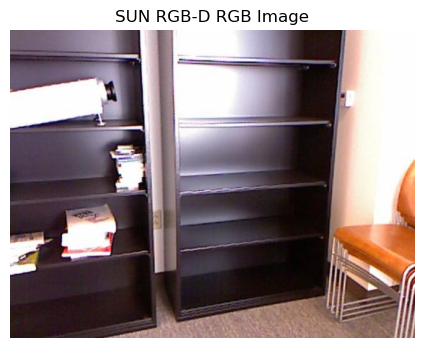

In [11]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline

def load_rgb_image(img_dir):
    image_folder = os.path.join(img_dir, "image")
    files = [f for f in os.listdir(image_folder) if f.endswith(".jpg")]

    if not files:
        raise FileNotFoundError("No RGB image found")

    img_path = os.path.join(image_folder, files[0])
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    print(f"Loaded image: {files[0]}")
    print(f"Shape: {img_rgb.shape}, dtype: {img_rgb.dtype}")

    return img_rgb

img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"

img = load_rgb_image(img_dir)

plt.figure(figsize=(6, 4))
plt.imshow(img)
plt.axis("off")
plt.title("SUN RGB-D RGB Image")
plt.show()


In [12]:
def image_stats(img):
    print("Pixel statistics:")
    print(f"  Min: {img.min()}")
    print(f"  Max: {img.max()}")
    print(f"  Mean: {img.mean():.2f}")
    print(f"  Std: {img.std():.2f}")

image_stats(img)


Pixel statistics:
  Min: 0
  Max: 255
  Mean: 117.86
  Std: 84.43


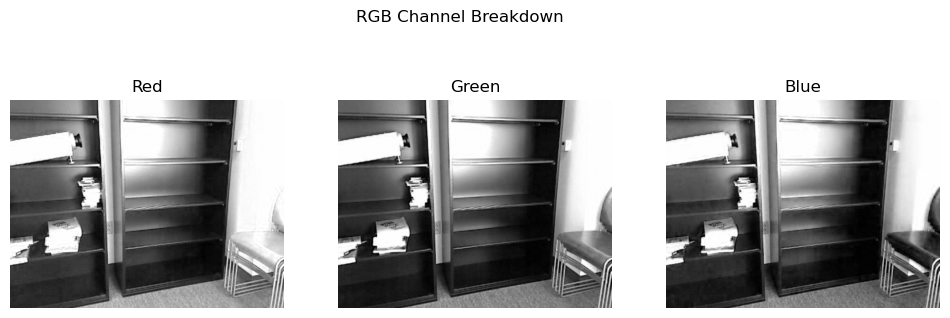

In [13]:
fig, axes = plt.subplots(1, 3, figsize=(12, 4))

channels = ['Red', 'Green', 'Blue']
for i in range(3):
    axes[i].imshow(img[:, :, i], cmap='gray')
    axes[i].set_title(channels[i])
    axes[i].axis('off')

plt.suptitle("RGB Channel Breakdown")
plt.show()


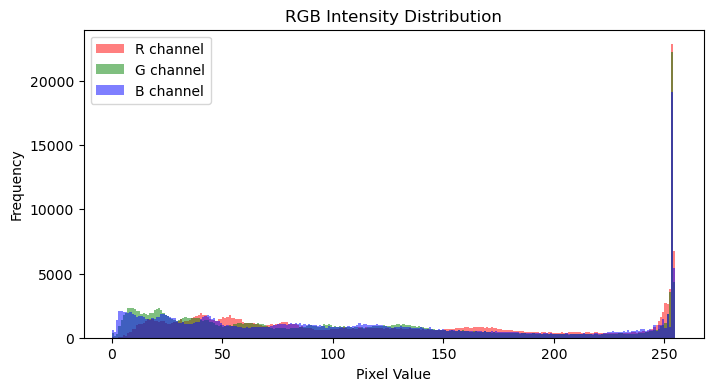

In [14]:
plt.figure(figsize=(8, 4))

colors = ['r', 'g', 'b']
for i, c in enumerate(colors):
    plt.hist(img[:, :, i].flatten(), bins=256, alpha=0.5, color=c, label=f'{c.upper()} channel')

plt.legend()
plt.title("RGB Intensity Distribution")
plt.xlabel("Pixel Value")
plt.ylabel("Frequency")
plt.show()


Loaded image: img_0063.jpg
Shape: (427, 561, 3), dtype: uint8
Loaded image: img_0064.jpg
Shape: (427, 561, 3), dtype: uint8
Loaded image: img_0065.jpg
Shape: (427, 561, 3), dtype: uint8
Loaded image: img_0066.jpg
Shape: (427, 561, 3), dtype: uint8


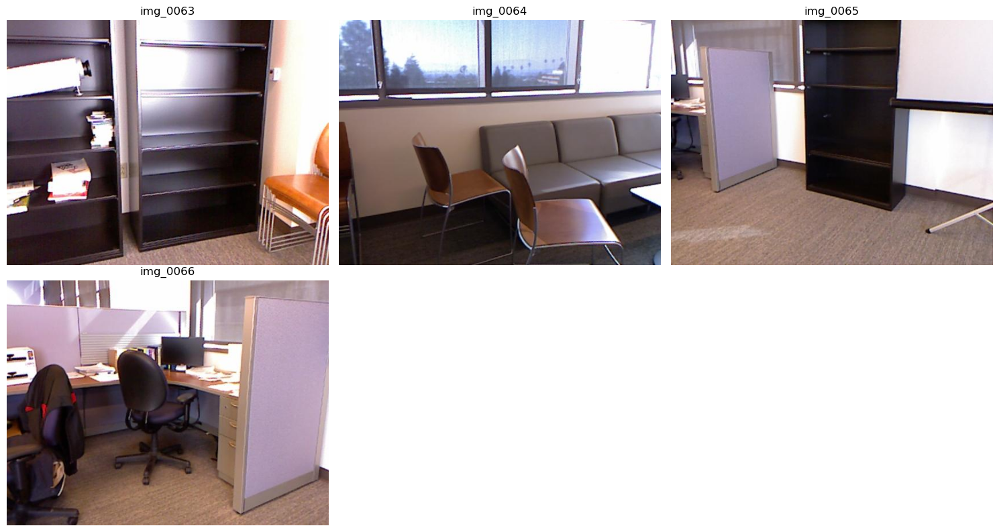

In [15]:
def plot_multiple_images(base_dir, img_ids, cols=3):
    rows = int(np.ceil(len(img_ids) / cols))
    plt.figure(figsize=(5 * cols, 4 * rows))

    for i, img_id in enumerate(img_ids):
        img_dir = os.path.join(base_dir, img_id)
        img = load_rgb_image(img_dir)

        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.title(img_id)
        plt.axis("off")

    plt.tight_layout()
    plt.show()

base_dir = "data/sunrgbd/kv1/b3dodata"
sample_imgs = ["img_0063", "img_0064", "img_0065", "img_0066"]

plot_multiple_images(base_dir, sample_imgs)


## Fullres vs Image

image/:     (427, 561, 3)
fullres/:   (480, 640, 3)


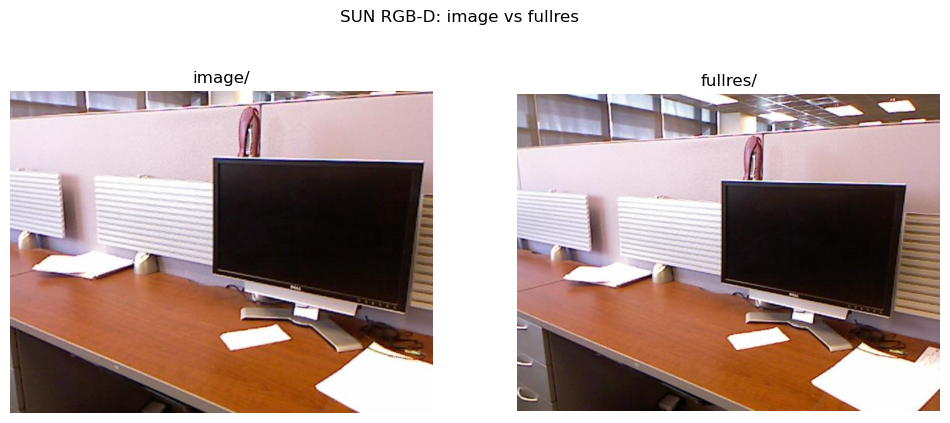

In [16]:
def load_image_pair(img_dir):
    image_dir = os.path.join(img_dir, "image")
    fullres_dir = os.path.join(img_dir, "fullres")

    img_file = [f for f in os.listdir(image_dir) if f.endswith(".jpg")][0]
    fullres_file = [f for f in os.listdir(fullres_dir) if f.endswith(".jpg")][0]

    img_path = os.path.join(image_dir, img_file)
    fullres_path = os.path.join(fullres_dir, fullres_file)

    img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
    fullres = cv2.cvtColor(cv2.imread(fullres_path), cv2.COLOR_BGR2RGB)

    print(f"image/:     {img.shape}")
    print(f"fullres/:   {fullres.shape}")

    return img, fullres


img_dir = "data/sunrgbd/kv1/b3dodata/img_0144"

img, fullres = load_image_pair(img_dir)

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(img)
plt.title("image/")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(fullres)
plt.title("fullres/")
plt.axis("off")

plt.suptitle("SUN RGB-D: image vs fullres")
plt.show()



In [17]:
def resolution_info(img, name):
    h, w = img.shape[:2]
    print(f"{name}: {w} x {h}  |  Aspect ratio: {w/h:.4f}")

resolution_info(img, "image")
resolution_info(fullres, "fullres")


image: 561 x 427  |  Aspect ratio: 1.3138
fullres: 640 x 480  |  Aspect ratio: 1.3333


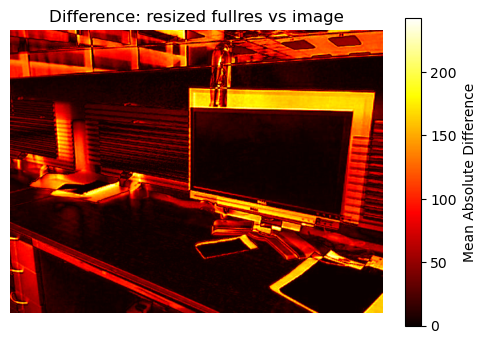

Mean pixel difference: 38.41548561799286
Max pixel difference: 243.0


In [18]:
fullres_resized = cv2.resize(
    fullres,
    (img.shape[1], img.shape[0]),
    interpolation=cv2.INTER_AREA
)

diff = np.abs(fullres_resized.astype(np.int16) - img.astype(np.int16))
diff_gray = diff.mean(axis=2)

plt.figure(figsize=(6, 4))
plt.imshow(diff_gray, cmap="hot")
plt.colorbar(label="Mean Absolute Difference")
plt.title("Difference: resized fullres vs image")
plt.axis("off")
plt.show()

print("Mean pixel difference:", diff_gray.mean())
print("Max pixel difference:", diff_gray.max())


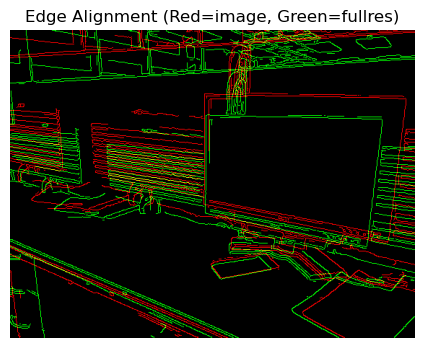

In [19]:
edges_img = cv2.Canny(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), 100, 200)
edges_full = cv2.Canny(cv2.cvtColor(fullres_resized, cv2.COLOR_RGB2GRAY), 100, 200)

overlay = np.zeros((*edges_img.shape, 3), dtype=np.uint8)
overlay[..., 0] = edges_img       # red = image
overlay[..., 1] = edges_full      # green = fullres resized

plt.figure(figsize=(6, 4))
plt.imshow(overlay)
plt.title("Edge Alignment (Red=image, Green=fullres)")
plt.axis("off")
plt.show()


In [20]:
fh, fw = fullres.shape[:2]
ih, iw = img.shape[:2]

y0 = (fh - ih) // 2
x0 = (fw - iw) // 2

center_crop = fullres[y0:y0+ih, x0:x0+iw]

diff_crop = np.abs(center_crop.astype(np.int16) - img.astype(np.int16)).mean()

print("Mean difference (center crop vs image):", diff_crop)


Mean difference (center crop vs image): 33.344722886670816


## Point Cloud Projection 

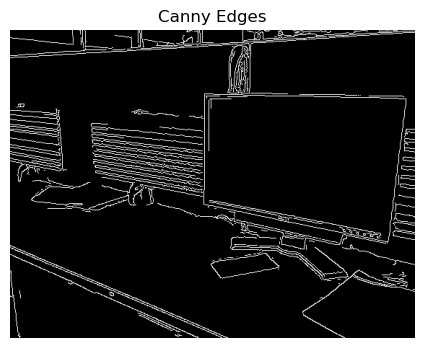

In [21]:
from mpl_toolkits.mplot3d import Axes3D


def load_rgb_depth_intrinsics(img_dir):
    # RGB
    img_path = os.path.join(img_dir, "image")
    img_file = [f for f in os.listdir(img_path) if f.endswith(".jpg")][0]
    img = cv2.cvtColor(cv2.imread(os.path.join(img_path, img_file)), cv2.COLOR_BGR2RGB)

    # Depth
    depth_path = os.path.join(img_dir, "depth")
    depth_file = [f for f in os.listdir(depth_path) if f.endswith(".png")][0]
    depth = cv2.imread(os.path.join(depth_path, depth_file), cv2.IMREAD_UNCHANGED)

    # Intrinsics
    K = np.loadtxt(os.path.join(img_dir, "intrinsics.txt"))

    return img, depth, K

img_dir = "data/sunrgbd/kv1/b3dodata/img_0144"
img, depth, K = load_rgb_depth_intrinsics(img_dir)

gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
edges = cv2.Canny(gray, threshold1=100, threshold2=200)

plt.figure(figsize=(6, 4))
plt.imshow(edges, cmap="gray")
plt.title("Canny Edges")
plt.axis("off")
plt.show()



In [22]:
depth_m = depth.astype(np.float32) / 1000.0  # mm → meters

valid_mask = (depth_m > 0) & np.isfinite(depth_m)


In [23]:
def edges_to_pointcloud(edges, depth_m, K, max_points=50000):
    fy, fx = K[1,1], K[0,0]
    cx, cy = K[0,2], K[1,2]

    ys, xs = np.where(edges & (depth_m > 0))

    if len(xs) > max_points:
        idx = np.random.choice(len(xs), max_points, replace=False)
        xs, ys = xs[idx], ys[idx]

    Z = depth_m[ys, xs]
    X = (xs - cx) * Z / fx
    Y = (ys - cy) * Z / fy

    points = np.stack([X, Y, Z], axis=1)
    return points

points_3d = edges_to_pointcloud(edges, depth_m, K)
print("3D points shape:", points_3d.shape)



3D points shape: (11374, 3)


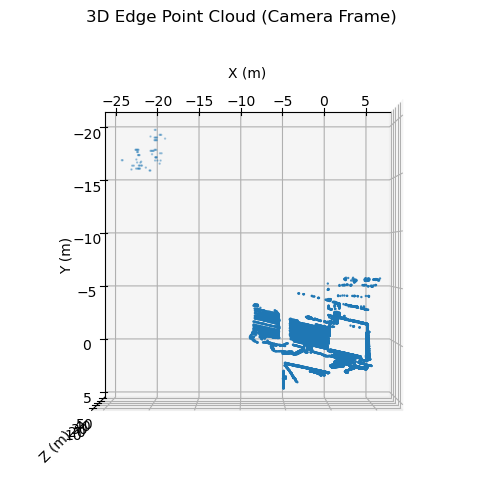

In [24]:
fig = plt.figure(figsize=(7, 6))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(
    points_3d[:, 0],
    points_3d[:, 1],
    points_3d[:, 2],
    s=0.5
)

ax.set_xlabel("X (m)")
ax.set_ylabel("Y (m)")
ax.set_zlabel("Z (m)")
ax.set_title("3D Edge Point Cloud (Camera Frame)")

# Camera-like view
ax.view_init(elev=-90, azim=-90)

plt.show()


In [25]:
import plotly.graph_objects as go
import numpy as np

print(points_3d.shape)

fig = go.Figure(
    data=[
        go.Scatter3d(
            x=points_3d[:, 0],
            y=points_3d[:, 1],
            z=points_3d[:, 2],
            mode='markers',
            marker=dict(
                size=1,
                opacity=0.8
            )
        )
    ]
)

fig.update_layout(
    title="Interactive 3D Edge Point Cloud (Camera Frame)",
    scene=dict(
        xaxis_title="X (meters)",
        yaxis_title="Y (meters)",
        zaxis_title="Z (meters)",
        aspectmode="data"  # important: true geometry
    ),
    margin=dict(l=0, r=0, t=40, b=0)
)

fig.show()


(11374, 3)


In [26]:
depth_colors = points_3d[:, 2]  # Z = depth

fig = go.Figure(
    data=[
        go.Scatter3d(
            x=points_3d[:, 0],
            y=points_3d[:, 1],
            z=points_3d[:, 2],
            mode='markers',
            marker=dict(
                size=1,
                color=depth_colors,
                colorscale='Viridis',
                opacity=0.85,
                colorbar=dict(title="Depth (m)")
            )
        )
    ]
)

fig.update_layout(
    title="3D Edge Point Cloud (Colored by Depth)",
    scene=dict(aspectmode="data"),
    margin=dict(l=0, r=0, t=40, b=0)
)

fig.show()


In [27]:
def color_points_by_rgb(points_3d, img, edges):
    ys, xs = np.where(edges)
    colors = img[ys, xs] / 255.0
    return colors[:points_3d.shape[0]]

rgb_colors = color_points_by_rgb(points_3d, img, edges)

fig = go.Figure(
    data=[
        go.Scatter3d(
            x=points_3d[:, 0],
            y=points_3d[:, 1],
            z=points_3d[:, 2],
            mode='markers',
            marker=dict(
                size=1,
                color=rgb_colors,
                opacity=0.9
            )
        )
    ]
)

fig.update_layout(
    title="3D Edge Point Cloud (RGB Colored)",
    scene=dict(aspectmode="data"),
    margin=dict(l=0, r=0, t=40, b=0)
)

fig.show()


In [28]:
fig.write_html("tests/plots/edge_pointcloud.html")


## Depth vs Depth_bfx

In [29]:
def load_depth_pair(img_dir):
    depth_path = os.path.join(img_dir, "depth")
    depth_bfx_path = os.path.join(img_dir, "depth_bfx")

    depth_file = os.listdir(depth_path)[0]
    depth_bfx_file = os.listdir(depth_bfx_path)[0]

    depth = cv2.imread(os.path.join(depth_path, depth_file), cv2.IMREAD_UNCHANGED)
    depth_bfx = cv2.imread(os.path.join(depth_bfx_path, depth_bfx_file), cv2.IMREAD_UNCHANGED)

    depth_m = depth.astype(np.float32) / 1000.0
    depth_bfx_m = depth_bfx.astype(np.float32) / 1000.0

    print("Depth shape:", depth_m.shape)
    print("Depth BFX shape:", depth_bfx_m.shape)

    return depth_m, depth_bfx_m

img_dir = "data/sunrgbd/kv1/b3dodata/img_0180"
depth, depth_bfx = load_depth_pair(img_dir)


Depth shape: (427, 561)
Depth BFX shape: (427, 561)


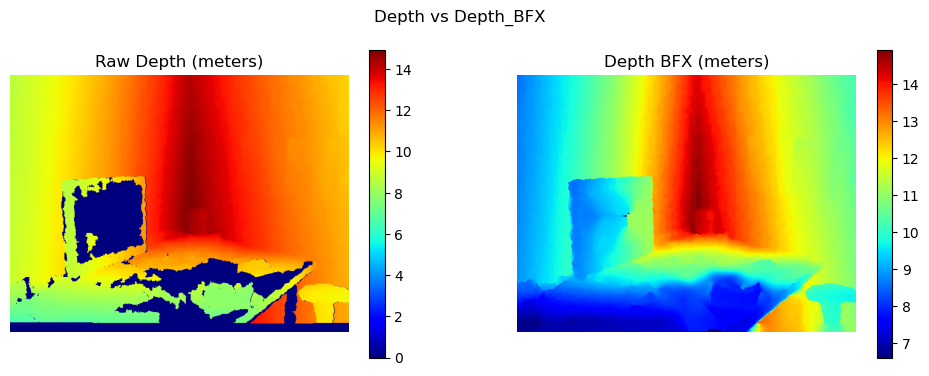

In [30]:
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.imshow(depth, cmap="jet")
plt.colorbar()
plt.title("Raw Depth (meters)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(depth_bfx, cmap="jet")
plt.colorbar()
plt.title("Depth BFX (meters)")
plt.axis("off")

plt.suptitle("Depth vs Depth_BFX")
plt.show()


In [31]:
valid_depth = depth > 0
valid_bfx = depth_bfx > 0

print("Valid depth pixels:", valid_depth.sum())
print("Valid depth_bfx pixels:", valid_bfx.sum())
print("Extra filled pixels:", valid_bfx.sum() - valid_depth.sum())


Valid depth pixels: 202997
Valid depth_bfx pixels: 239547
Extra filled pixels: 36550


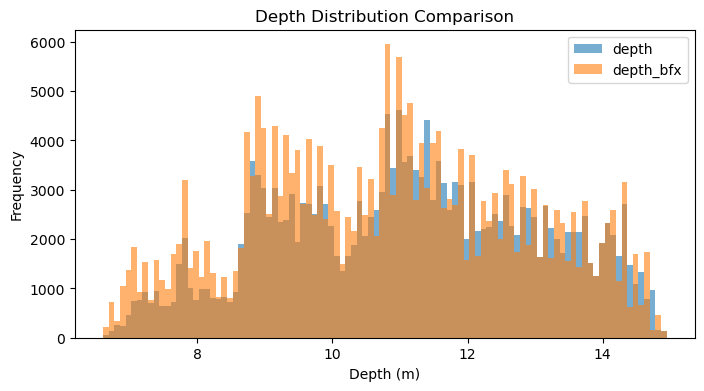

In [32]:
plt.figure(figsize=(8, 4))

plt.hist(depth[valid_depth].flatten(), bins=100, alpha=0.6, label="depth")
plt.hist(depth_bfx[valid_bfx].flatten(), bins=100, alpha=0.6, label="depth_bfx")

plt.xlabel("Depth (m)")
plt.ylabel("Frequency")
plt.legend()
plt.title("Depth Distribution Comparison")
plt.show()


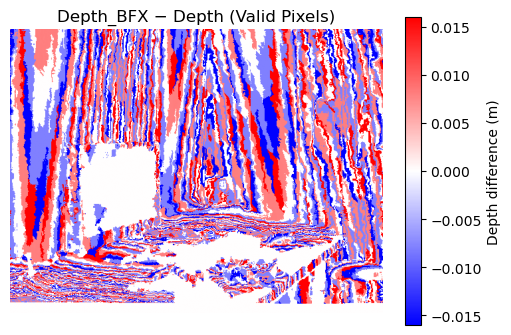

Mean diff: -0.00017017889
Std diff: 0.009936025


In [33]:
diff = np.zeros_like(depth)
mask = valid_depth & valid_bfx
diff[mask] = depth_bfx[mask] - depth[mask]

plt.figure(figsize=(6, 4))
plt.imshow(diff, cmap="bwr")
plt.colorbar(label="Depth difference (m)")
plt.title("Depth_BFX − Depth (Valid Pixels)")
plt.axis("off")
plt.show()

print("Mean diff:", diff[mask].mean())
print("Std diff:", diff[mask].std())


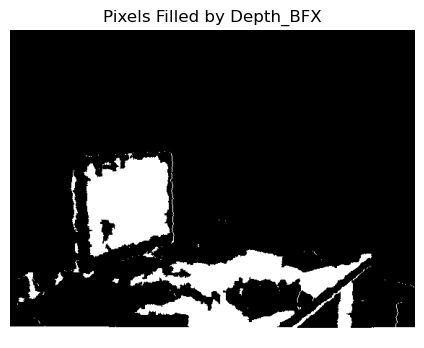

Filled pixels count: 36550


In [34]:
filled_only = (depth == 0) & (depth_bfx > 0)

plt.figure(figsize=(6, 4))
plt.imshow(filled_only, cmap="gray")
plt.title("Pixels Filled by Depth_BFX")
plt.axis("off")
plt.show()

print("Filled pixels count:", filled_only.sum())


In [35]:
def depth_to_pointcloud(depth_m, K, max_points=50000):
    fy, fx = K[1,1], K[0,0]
    cx, cy = K[0,2], K[1,2]

    ys, xs = np.where(depth_m > 0)
    if len(xs) > max_points:
        idx = np.random.choice(len(xs), max_points, replace=False)
        xs, ys = xs[idx], ys[idx]

    Z = depth_m[ys, xs]
    X = (xs - cx) * Z / fx
    Y = (ys - cy) * Z / fy

    return np.stack([X, Y, Z], axis=1)

K = np.loadtxt(os.path.join(img_dir, "intrinsics.txt"))

pc_depth = depth_to_pointcloud(depth, K)
pc_bfx = depth_to_pointcloud(depth_bfx, K)

print("Point cloud size (depth):", pc_depth.shape)
print("Point cloud size (bfx):", pc_bfx.shape)


Point cloud size (depth): (50000, 3)
Point cloud size (bfx): (50000, 3)


In [36]:

from scipy.spatial import Delaunay

def load_rgb_depth_pair(img_dir):
    img = cv2.cvtColor(
        cv2.imread(os.path.join(img_dir, "image",
        os.listdir(os.path.join(img_dir, "image"))[0])),
        cv2.COLOR_BGR2RGB
    )

    depth = cv2.imread(
        os.path.join(img_dir, "depth",
        os.listdir(os.path.join(img_dir, "depth"))[0]),
        cv2.IMREAD_UNCHANGED
    ).astype(np.float32) / 1000.0

    depth_bfx = cv2.imread(
        os.path.join(img_dir, "depth_bfx",
        os.listdir(os.path.join(img_dir, "depth_bfx"))[0]),
        cv2.IMREAD_UNCHANGED
    ).astype(np.float32) / 1000.0

    K = np.loadtxt(os.path.join(img_dir, "intrinsics.txt"))
    return img, depth, depth_bfx, K

img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"
img, depth, depth_bfx, K = load_rgb_depth_pair(img_dir)




In [37]:
def depth_to_points(depth, K, mask=None, max_points=80000):
    fx, fy = K[0,0], K[1,1]
    cx, cy = K[0,2], K[1,2]

    if mask is None:
        mask = depth > 0

    ys, xs = np.where(mask)
    if len(xs) > max_points:
        ids = np.random.choice(len(xs), max_points, replace=False)
        xs, ys = xs[ids], ys[ids]

    Z = depth[ys, xs]
    X = (xs - cx) * Z / fx
    Y = (ys - cy) * Z / fy
    return np.column_stack((X, Y, Z))


pc_raw = depth_to_points(depth, K)
pc_bfx = depth_to_points(depth_bfx, K)



In [38]:
fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=pc_raw[:,0], y=pc_raw[:,1], z=pc_raw[:,2],
    mode='markers', marker=dict(size=1),
    name='Raw Depth'
))

fig.add_trace(go.Scatter3d(
    x=pc_bfx[:,0], y=pc_bfx[:,1], z=pc_bfx[:,2],
    mode='markers', marker=dict(size=1),
    name='Depth_BFX'
))

fig.update_layout(scene=dict(aspectmode='data'),
                  title="Raw vs Depth_BFX Point Clouds")
fig.show()


In [39]:
mask = (depth > 0) & (depth_bfx > 0)
delta = depth_bfx - depth

pc_delta = depth_to_points(depth, K, mask)
delta_vals = delta[mask][:len(pc_delta)]


In [40]:
fig = go.Figure(go.Scatter3d(
    x=pc_delta[:,0], y=pc_delta[:,1], z=pc_delta[:,2],
    mode='markers',
    marker=dict(size=1, color=delta_vals,
                colorscale='RdBu',
                colorbar=dict(title="ΔZ (m)"))
))

fig.update_layout(scene=dict(aspectmode='data'),
                  title="3D Difference Cloud (Depth_BFX − Raw)")
fig.show()


In [41]:
edges = cv2.Canny(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), 100, 200)

pc_edge_raw = depth_to_points(depth, K, (edges > 0) & (depth > 0))
pc_edge_bfx = depth_to_points(depth_bfx, K, (edges > 0) & (depth_bfx > 0))


In [42]:
fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=pc_edge_raw[:,0], y=pc_edge_raw[:,1], z=pc_edge_raw[:,2],
    mode='markers', marker=dict(size=2),
    name='Edges Raw'
))

fig.add_trace(go.Scatter3d(
    x=pc_edge_bfx[:,0], y=pc_edge_bfx[:,1], z=pc_edge_bfx[:,2],
    mode='markers', marker=dict(size=2),
    name='Edges BFX'
))

fig.update_layout(scene=dict(aspectmode='data'),
                  title="Edge-Based 3D Geometry")
fig.show()


In [43]:
def ransac_plane_fit(points, iters=1000, threshold=0.02):
    best = []
    N = len(points)

    for _ in range(iters):
        ids = np.random.choice(N, 3, replace=False)
        p1, p2, p3 = points[ids]

        normal = np.cross(p2-p1, p3-p1)
        if np.linalg.norm(normal) < 1e-6:
            continue

        normal /= np.linalg.norm(normal)
        d = -np.dot(normal, p1)

        dist = np.abs(points @ normal + d)
        inliers = points[dist < threshold]

        if len(inliers) > len(best):
            best = inliers

    return np.array(best)


In [44]:
plane_raw = ransac_plane_fit(pc_raw)
plane_bfx = ransac_plane_fit(pc_bfx)


fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=plane_raw[:,0], y=plane_raw[:,1], z=plane_raw[:,2],
    mode='markers', name='Raw Plane'
))

fig.add_trace(go.Scatter3d(
    x=plane_bfx[:,0], y=plane_bfx[:,1], z=plane_bfx[:,2],
    mode='markers', name='BFX Plane'
))

fig.update_layout(scene=dict(aspectmode='data'),
                  title="Plane Extraction Comparison")
fig.show()


In [45]:
xy = pc_bfx[:, :2]
tri = Delaunay(xy)

fig = go.Figure(go.Mesh3d(
    x=pc_bfx[:,0], y=pc_bfx[:,1], z=pc_bfx[:,2],
    i=tri.simplices[:,0],
    j=tri.simplices[:,1],
    k=tri.simplices[:,2],
    opacity=0.5
))

fig.update_layout(scene=dict(aspectmode='data'),
                  title="Surface Mesh (Depth_BFX)")
fig.show()


In [46]:
def camera_rays(depth, K, step=40):
    fx, fy = K[0,0], K[1,1]
    cx, cy = K[0,2], K[1,2]

    rays = []
    for y in range(0, depth.shape[0], step):
        for x in range(0, depth.shape[1], step):
            if depth[y,x] > 0:
                Z = depth[y,x]
                X = (x-cx)*Z/fx
                Y = (y-cy)*Z/fy
                rays.append(([0,0,0],[X,Y,Z]))
    return rays


In [47]:
fig = go.Figure()
for a,b in camera_rays(depth_bfx, K)[:200]:
    fig.add_trace(go.Scatter3d(
        x=[a[0],b[0]], y=[a[1],b[1]], z=[a[2],b[2]],
        mode='lines'
    ))

fig.update_layout(scene=dict(aspectmode='data'),
                  title="Camera Rays")
fig.show()


In [48]:
def camera_frustum(K, w=561, h=427, z=4):
    fx, fy = K[0,0], K[1,1]
    cx, cy = K[0,2], K[1,2]

    corners = []
    for x,y in [(0,0),(w,0),(w,h),(0,h)]:
        corners.append([(x-cx)*z/fx,(y-cy)*z/fy,z])
    return corners


In [49]:
f = camera_frustum(K)

fig = go.Figure(go.Scatter3d(
    x=[0]+[p[0] for p in f],
    y=[0]+[p[1] for p in f],
    z=[0]+[p[2] for p in f],
    mode='lines+markers'
))

fig.update_layout(scene=dict(aspectmode='data'),
                  title="Camera Frustum")
fig.show()


In [50]:
err = np.abs(depth_bfx - depth)
pc_err = depth_to_points(depth_bfx, K, err > 0)
err_vals = err[err > 0][:len(pc_err)]

fig = go.Figure(go.Scatter3d(
    x=pc_err[:,0], y=pc_err[:,1], z=pc_err[:,2],
    mode='markers',
    marker=dict(size=1, color=err_vals,
                colorscale='Inferno',
                colorbar=dict(title="Error (m)"))
))

fig.update_layout(scene=dict(aspectmode='data'),
                  title="Reprojection Error Volume")
fig.show()



## Understanding the Annotation 


TOP-LEVEL KEYS
['date', 'name', 'frames', 'objects', 'extrinsics', 'conflictList', 'fileList']

FULL STRUCTURE (TRUNCATED)
date: str
  Sun,15Feb201511:00:00GMT
name: str
  http://vision.princeton.edu/data/dataset/user/shurans@princeton.edu/SUN-RGBD/b3do/img_0063/annotation/index.json
frames: list
  list[1]
    polygon: list
      list[9]
        x: list
          ...
        y: list
          ...
        XYZ: list
          ...
        object: int
          ...
        annotator: str
          ...
objects: list
  list[6]
    name: str
      shelf
extrinsics: str
  20140915210114.txt
conflictList: list
  list[1]
    None
fileList: list
  list[1]
    http://vision.princeton.edu/data/dataset/user/shurans@princeton.edu/SUN-RGBD/b3do/img_0063/image/img_0063.jpg

NUMBER OF FRAMES: 1

Frame[0] keys:
dict_keys(['polygon'])

Frame[0] content:
{'polygon': [{'XYZ': [[0.6463785768, -0.8149276972, 1.68589294],
                      [1.114413023, -0.8906619549, 1.849921346],
                      [

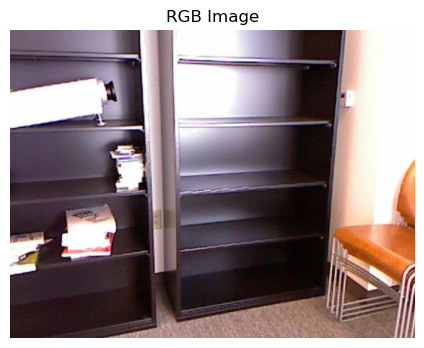

In [51]:
import os
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pprint import pprint

# ------------------------------------
# Paths
# ------------------------------------
img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"
anno_path = os.path.join(img_dir, "annotation", "index.json")

# ------------------------------------
# Load annotation
# ------------------------------------
with open(anno_path, "r") as f:
    anno = json.load(f)

print("\n==============================")
print("TOP-LEVEL KEYS")
print("==============================")
pprint(list(anno.keys()))

# ------------------------------------
# Utility: recursive structure dump
# ------------------------------------
def dump_structure(obj, indent=0, max_depth=4):
    prefix = "  " * indent
    if indent > max_depth:
        print(prefix + "...")
        return

    if isinstance(obj, dict):
        for k, v in obj.items():
            print(f"{prefix}{k}: {type(v).__name__}")
            dump_structure(v, indent + 1, max_depth)
    elif isinstance(obj, list):
        print(f"{prefix}list[{len(obj)}]")
        if len(obj) > 0:
            dump_structure(obj[0], indent + 1, max_depth)
    else:
        print(f"{prefix}{obj}")

print("\n==============================")
print("FULL STRUCTURE (TRUNCATED)")
print("==============================")
dump_structure(anno)

# ------------------------------------
# Inspect frames
# ------------------------------------
frames = anno.get("frames", [])
print("\n==============================")
print(f"NUMBER OF FRAMES: {len(frames)}")
print("==============================")

if len(frames) > 0:
    print("\nFrame[0] keys:")
    pprint(frames[0].keys())
    print("\nFrame[0] content:")
    pprint(frames[0])

# ------------------------------------
# Inspect objects
# ------------------------------------
objects = anno.get("objects", [])
print("\n==============================")
print(f"NUMBER OF OBJECTS: {len(objects)}")
print("==============================")

for i, obj in enumerate(objects):
    print(f"\nObject {i}:")
    pprint(obj)

# ------------------------------------
# Inspect extrinsics
# ------------------------------------
print("\n==============================")
print("EXTRINSICS")
print("==============================")
print(anno.get("extrinsics"))

# ------------------------------------
# Inspect fileList
# ------------------------------------
file_list = anno.get("fileList", [])
print("\n==============================")
print("FILE LIST")
print("==============================")
pprint(file_list)

# ------------------------------------
# Load RGB image
# ------------------------------------
img_path = os.path.join(img_dir, "image", os.listdir(os.path.join(img_dir, "image"))[0])
img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(6, 4))
plt.imshow(img)
plt.title("RGB Image")
plt.axis("off")
plt.show()


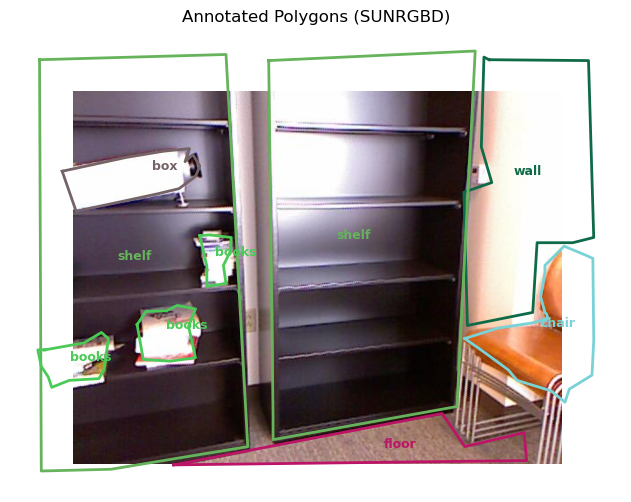

In [52]:

img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"

with open(os.path.join(img_dir, "annotation", "index.json"), "r") as f:
    anno = json.load(f)

img_path = os.path.join(img_dir, "image", os.listdir(os.path.join(img_dir, "image"))[0])
img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

polygons = anno["frames"][0]["polygon"]
objects = anno["objects"]

np.random.seed(42)
colors = {
    i: np.random.randint(0, 255, size=3)
    for i in range(len(objects))
}

plt.figure(figsize=(8, 6))
plt.imshow(img)
plt.axis("off")

for poly in polygons:
    xs = np.array(poly["x"])
    ys = np.array(poly["y"])
    obj_id = poly["object"]
    label = objects[obj_id]["name"]
    color = colors[obj_id] / 255.0

    # Close polygon
    xs = np.append(xs, xs[0])
    ys = np.append(ys, ys[0])

    plt.plot(xs, ys, color=color, linewidth=2)

    # Label at centroid
    cx, cy = np.mean(xs), np.mean(ys)
    plt.text(cx, cy, label, color=color, fontsize=9, weight="bold")

plt.title("Annotated Polygons (SUNRGBD)")
plt.show()


## Understanding Annotation2Dfinal


TOP-LEVEL KEYS
['date', 'name', 'frames', 'objects', 'extrinsics', 'conflictList', 'fileList']

FULL STRUCTURE (TRUNCATED)
date: str
  Sun,15Feb201511:00:00GMT
name: str
  http://vision.princeton.edu/data/dataset/user/shurans@princeton.edu/SUN-RGBD/b3do/img_0063/annotation/index.json
frames: list
  list[1]
    polygon: list
      list[9]
        x: list
          ...
        y: list
          ...
        XYZ: list
          ...
        object: int
          ...
        annotator: str
          ...
objects: list
  list[6]
    name: str
      shelf
extrinsics: str
  20140915210114.txt
conflictList: list
  list[1]
    None
fileList: list
  list[1]
    http://vision.princeton.edu/data/dataset/user/shurans@princeton.edu/SUN-RGBD/b3do/img_0063/image/img_0063.jpg

NUMBER OF FRAMES: 1

Frame[0] keys:
dict_keys(['polygon'])

Frame[0] content:
{'polygon': [{'XYZ': [[0.6463785768, -0.8149276972, 1.68589294],
                      [1.114413023, -0.8906619549, 1.849921346],
                      [

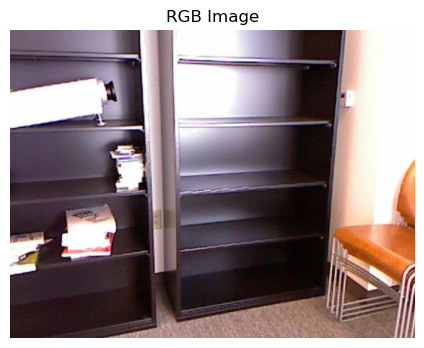

In [53]:
import os
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pprint import pprint

# ------------------------------------
# Paths
# ------------------------------------
img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"
anno_path = os.path.join(img_dir, "annotation2Dfinal", "index.json")

# ------------------------------------
# Load annotation
# ------------------------------------
with open(anno_path, "r") as f:
    anno = json.load(f)

print("\n==============================")
print("TOP-LEVEL KEYS")
print("==============================")
pprint(list(anno.keys()))

# ------------------------------------
# Utility: recursive structure dump
# ------------------------------------
def dump_structure(obj, indent=0, max_depth=4):
    prefix = "  " * indent
    if indent > max_depth:
        print(prefix + "...")
        return

    if isinstance(obj, dict):
        for k, v in obj.items():
            print(f"{prefix}{k}: {type(v).__name__}")
            dump_structure(v, indent + 1, max_depth)
    elif isinstance(obj, list):
        print(f"{prefix}list[{len(obj)}]")
        if len(obj) > 0:
            dump_structure(obj[0], indent + 1, max_depth)
    else:
        print(f"{prefix}{obj}")

print("\n==============================")
print("FULL STRUCTURE (TRUNCATED)")
print("==============================")
dump_structure(anno)

# ------------------------------------
# Inspect frames
# ------------------------------------
frames = anno.get("frames", [])
print("\n==============================")
print(f"NUMBER OF FRAMES: {len(frames)}")
print("==============================")

if len(frames) > 0:
    print("\nFrame[0] keys:")
    pprint(frames[0].keys())
    print("\nFrame[0] content:")
    pprint(frames[0])

# ------------------------------------
# Inspect objects
# ------------------------------------
objects = anno.get("objects", [])
print("\n==============================")
print(f"NUMBER OF OBJECTS: {len(objects)}")
print("==============================")

for i, obj in enumerate(objects):
    print(f"\nObject {i}:")
    pprint(obj)

# ------------------------------------
# Inspect extrinsics
# ------------------------------------
print("\n==============================")
print("EXTRINSICS")
print("==============================")
print(anno.get("extrinsics"))

# ------------------------------------
# Inspect fileList
# ------------------------------------
file_list = anno.get("fileList", [])
print("\n==============================")
print("FILE LIST")
print("==============================")
pprint(file_list)

# ------------------------------------
# Load RGB image
# ------------------------------------
img_path = os.path.join(img_dir, "image", os.listdir(os.path.join(img_dir, "image"))[0])
img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(6, 4))
plt.imshow(img)
plt.title("RGB Image")
plt.axis("off")
plt.show()


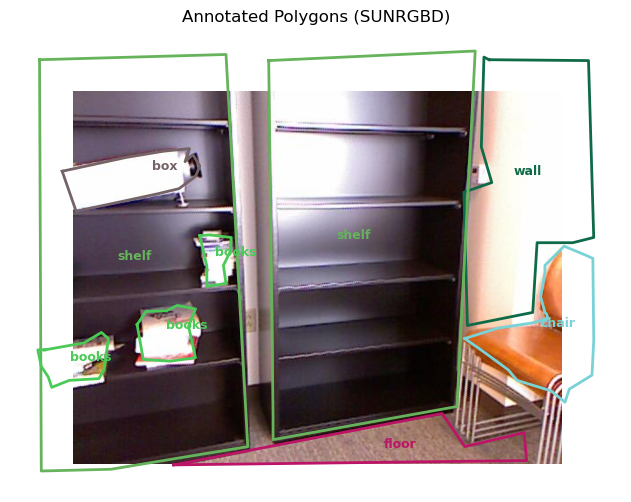

In [54]:

img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"

with open(os.path.join(img_dir, "annotation2Dfinal", "index.json"), "r") as f:
    anno = json.load(f)

img_path = os.path.join(img_dir, "image", os.listdir(os.path.join(img_dir, "image"))[0])
img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

polygons = anno["frames"][0]["polygon"]
objects = anno["objects"]

np.random.seed(42)
colors = {
    i: np.random.randint(0, 255, size=3)
    for i in range(len(objects))
}

plt.figure(figsize=(8, 6))
plt.imshow(img)
plt.axis("off")

for poly in polygons:
    xs = np.array(poly["x"])
    ys = np.array(poly["y"])
    obj_id = poly["object"]
    label = objects[obj_id]["name"]
    color = colors[obj_id] / 255.0

    # Close polygon
    xs = np.append(xs, xs[0])
    ys = np.append(ys, ys[0])

    plt.plot(xs, ys, color=color, linewidth=2)

    # Label at centroid
    cx, cy = np.mean(xs), np.mean(ys)
    plt.text(cx, cy, label, color=color, fontsize=9, weight="bold")

plt.title("Annotated Polygons (SUNRGBD)")
plt.show()


## Understanding Annotation2D3D


TOP-LEVEL KEYS
['date', 'name', 'frames', 'objects', 'extrinsics', 'conflictList', 'fileList']

FULL STRUCTURE (TRUNCATED)
date: str
  Fri, 10 Jul 2015 13:01:37 GMT
name: str
  http://vision.princeton.edu/data/dataset/shared/SUNRGBD/kv1/b3dodata/img_0063/annotation2D3D/index.json
frames: list
  list[1]
    polygon: list
      list[7]
        x: list
          ...
        y: list
          ...
        object: int
          ...
        rect: int
          ...
        annotator: str
          ...
objects: list
  list[7]
    name: str
      bookshelf
    polygon: list
      list[1]
        Ymin: float
          ...
        Ymax: float
          ...
        rectangle: int
          ...
        X: list
          ...
        Z: list
          ...
extrinsics: str
  20140915210114.txt
conflictList: list
  list[1]
    None
fileList: list
  list[1]
    http://vision.princeton.edu/data/dataset/shared/SUNRGBD/kv1/b3dodata/img_0063/image/img_0063.jpg

NUMBER OF FRAMES: 1

Frame[0] keys:
dict_keys([

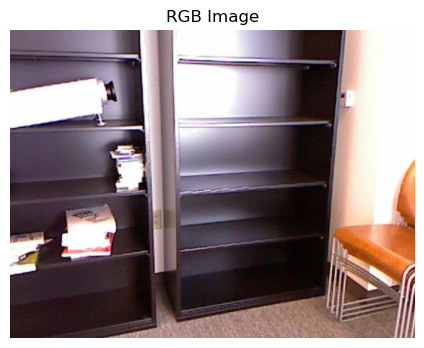

In [55]:
import os
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pprint import pprint

# ------------------------------------
# Paths
# ------------------------------------
img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"
anno_path = os.path.join(img_dir, "annotation2D3D", "index.json")

# ------------------------------------
# Load annotation
# ------------------------------------
with open(anno_path, "r") as f:
    anno = json.load(f)

print("\n==============================")
print("TOP-LEVEL KEYS")
print("==============================")
pprint(list(anno.keys()))

# ------------------------------------
# Utility: recursive structure dump
# ------------------------------------
def dump_structure(obj, indent=0, max_depth=4):
    prefix = "  " * indent
    if indent > max_depth:
        print(prefix + "...")
        return

    if isinstance(obj, dict):
        for k, v in obj.items():
            print(f"{prefix}{k}: {type(v).__name__}")
            dump_structure(v, indent + 1, max_depth)
    elif isinstance(obj, list):
        print(f"{prefix}list[{len(obj)}]")
        if len(obj) > 0:
            dump_structure(obj[0], indent + 1, max_depth)
    else:
        print(f"{prefix}{obj}")

print("\n==============================")
print("FULL STRUCTURE (TRUNCATED)")
print("==============================")
dump_structure(anno)

# ------------------------------------
# Inspect frames
# ------------------------------------
frames = anno.get("frames", [])
print("\n==============================")
print(f"NUMBER OF FRAMES: {len(frames)}")
print("==============================")

if len(frames) > 0:
    print("\nFrame[0] keys:")
    pprint(frames[0].keys())
    print("\nFrame[0] content:")
    pprint(frames[0])

# ------------------------------------
# Inspect objects
# ------------------------------------
objects = anno.get("objects", [])
print("\n==============================")
print(f"NUMBER OF OBJECTS: {len(objects)}")
print("==============================")

for i, obj in enumerate(objects):
    print(f"\nObject {i}:")
    pprint(obj)

# ------------------------------------
# Inspect extrinsics
# ------------------------------------
print("\n==============================")
print("EXTRINSICS")
print("==============================")
print(anno.get("extrinsics"))

# ------------------------------------
# Inspect fileList
# ------------------------------------
file_list = anno.get("fileList", [])
print("\n==============================")
print("FILE LIST")
print("==============================")
pprint(file_list)

# ------------------------------------
# Load RGB image
# ------------------------------------
img_path = os.path.join(img_dir, "image", os.listdir(os.path.join(img_dir, "image"))[0])
img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(6, 4))
plt.imshow(img)
plt.title("RGB Image")
plt.axis("off")
plt.show()


In [56]:
import plotly.express as px
# -----------------------------
# Load annotation2D3D
# -----------------------------
img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"
anno_path = os.path.join(img_dir, "annotation2D3D", "index.json")

with open(anno_path, "r") as f:
    anno = json.load(f)

objects = anno["objects"]

def rectangle_to_3d_vertices(poly):
    X = np.array(poly["X"])
    Z = np.array(poly["Z"])
    y_min = poly["Ymin"]
    y_max = poly["Ymax"]

    bottom = np.stack([X, np.full(4, y_min), Z], axis=1)
    top = np.stack([X, np.full(4, y_max), Z], axis=1)

    return bottom, top

fig = go.Figure()
colors = px.colors.qualitative.Set2

for i, obj in enumerate(objects):
    name = obj["name"]
    poly = obj["polygon"][0]

    bottom, top = rectangle_to_3d_vertices(poly)
    color = colors[i % len(colors)]

    # Bottom face
    fig.add_trace(go.Scatter3d(
        x=np.append(bottom[:,0], bottom[0,0]),
        y=np.append(bottom[:,1], bottom[0,1]),
        z=np.append(bottom[:,2], bottom[0,2]),
        mode="lines",
        name=f"{name} (bottom)",
        line=dict(color=color, width=4)
    ))

    # Top face
    fig.add_trace(go.Scatter3d(
        x=np.append(top[:,0], top[0,0]),
        y=np.append(top[:,1], top[0,1]),
        z=np.append(top[:,2], top[0,2]),
        mode="lines",
        showlegend=False,
        line=dict(color=color, width=4)
    ))

    # Vertical edges
    for j in range(4):
        fig.add_trace(go.Scatter3d(
            x=[bottom[j,0], top[j,0]],
            y=[bottom[j,1], top[j,1]],
            z=[bottom[j,2], top[j,2]],
            mode="lines",
            showlegend=False,
            line=dict(color=color, width=2)
        ))

    # Label
    center = (bottom.mean(axis=0) + top.mean(axis=0)) / 2
    fig.add_trace(go.Scatter3d(
        x=[center[0]], y=[center[1]], z=[center[2]],
        mode="text",
        text=[name],
        showlegend=False
    ))

fig.update_layout(
    title="3D Annotated Object Polygons (Wireframe)",
    scene=dict(
        xaxis_title="X (right)",
        yaxis_title="Y (down)",
        zaxis_title="Z (depth)"
    ),
    height=700
)

fig.show()




In [57]:
points = []
labels = []

for i, obj in enumerate(objects):
    poly = obj["polygon"][0]
    bottom, top = rectangle_to_3d_vertices(poly)

    verts = np.vstack([bottom, top])
    points.append(verts)
    labels += [obj["name"]] * len(verts)

points = np.vstack(points)

fig = go.Figure(go.Scatter3d(
    x=points[:,0],
    y=points[:,1],
    z=points[:,2],
    mode="markers",
    marker=dict(
        size=6,
        color=[hash(l) % 10 for l in labels],
        colorscale="Turbo"
    ),
    text=labels
))

fig.update_layout(
    title="3D Annotation Vertices (Point Cloud)",
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Z"
    ),
    height=700
)

fig.show()


In [58]:
fig = go.Figure()

# Camera origin
fig.add_trace(go.Scatter3d(
    x=[0], y=[0], z=[0],
    mode="markers+text",
    marker=dict(size=8, color="red"),
    text=["Camera"],
    name="Camera"
))

for i, obj in enumerate(objects):
    name = obj["name"]
    poly = obj["polygon"][0]
    bottom, top = rectangle_to_3d_vertices(poly)
    color = colors[i % len(colors)]

    faces = np.vstack([bottom, top])

    fig.add_trace(go.Mesh3d(
        x=faces[:,0],
        y=faces[:,1],
        z=faces[:,2],
        color=color,
        opacity=0.35,
        name=name
    ))

fig.update_layout(
    title="3D Scene with Annotated Objects + Camera",
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Z"
    ),
    height=700
)

fig.show()


## Understanding Annotation3D and Annotation3Dfinal 


TOP-LEVEL KEYS
['date', 'name', 'frames', 'objects', 'extrinsics', 'conflictList', 'fileList']

FULL STRUCTURE (TRUNCATED)
date: str
  Wed, 04 Mar 2015 02:38:57 GMT
name: str
  b3do/img_0063//
frames: list
  list[1]
objects: list
  list[10]
    name: str
      bookshelf
    polygon: list
      list[1]
        Ymin: float
          ...
        Ymax: float
          ...
        rectangle: bool
          ...
        X: list
          ...
        Z: list
          ...
extrinsics: str
  20140915210114.txt
conflictList: list
  list[1]
    None
fileList: list
  list[1]
    img_0063.jpg

NUMBER OF FRAMES: 1

Frame[0] keys:
dict_keys([])

Frame[0] content:
{}

NUMBER OF OBJECTS: 10

Object 0:
{'name': 'bookshelf',
 'polygon': [{'X': [-0.15,
                    0.6968309773606108,
                    0.5599692604758523,
                    -0.2868617168847586],
              'Ymax': 1.0772727272727274,
              'Ymin': -0.6590909090909091,
              'Z': [1.7454545454545454,
          

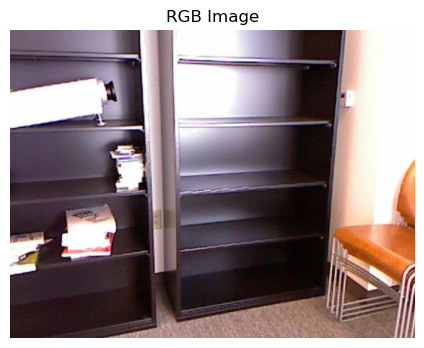

In [59]:
import os
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pprint import pprint

# ------------------------------------
# Paths
# ------------------------------------
img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"
anno_path = os.path.join(img_dir, "annotation3Dfinal", "index.json")

# ------------------------------------
# Load annotation
# ------------------------------------
with open(anno_path, "r") as f:
    anno = json.load(f)

print("\n==============================")
print("TOP-LEVEL KEYS")
print("==============================")
pprint(list(anno.keys()))

# ------------------------------------
# Utility: recursive structure dump
# ------------------------------------
def dump_structure(obj, indent=0, max_depth=4):
    prefix = "  " * indent
    if indent > max_depth:
        print(prefix + "...")
        return

    if isinstance(obj, dict):
        for k, v in obj.items():
            print(f"{prefix}{k}: {type(v).__name__}")
            dump_structure(v, indent + 1, max_depth)
    elif isinstance(obj, list):
        print(f"{prefix}list[{len(obj)}]")
        if len(obj) > 0:
            dump_structure(obj[0], indent + 1, max_depth)
    else:
        print(f"{prefix}{obj}")

print("\n==============================")
print("FULL STRUCTURE (TRUNCATED)")
print("==============================")
dump_structure(anno)

# ------------------------------------
# Inspect frames
# ------------------------------------
frames = anno.get("frames", [])
print("\n==============================")
print(f"NUMBER OF FRAMES: {len(frames)}")
print("==============================")

if len(frames) > 0:
    print("\nFrame[0] keys:")
    pprint(frames[0].keys())
    print("\nFrame[0] content:")
    pprint(frames[0])

# ------------------------------------
# Inspect objects
# ------------------------------------
objects = anno.get("objects", [])
print("\n==============================")
print(f"NUMBER OF OBJECTS: {len(objects)}")
print("==============================")

for i, obj in enumerate(objects):
    print(f"\nObject {i}:")
    pprint(obj)

# ------------------------------------
# Inspect extrinsics
# ------------------------------------
print("\n==============================")
print("EXTRINSICS")
print("==============================")
print(anno.get("extrinsics"))

# ------------------------------------
# Inspect fileList
# ------------------------------------
file_list = anno.get("fileList", [])
print("\n==============================")
print("FILE LIST")
print("==============================")
pprint(file_list)

# ------------------------------------
# Load RGB image
# ------------------------------------
img_path = os.path.join(img_dir, "image", os.listdir(os.path.join(img_dir, "image"))[0])
img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(6, 4))
plt.imshow(img)
plt.title("RGB Image")
plt.axis("off")
plt.show()


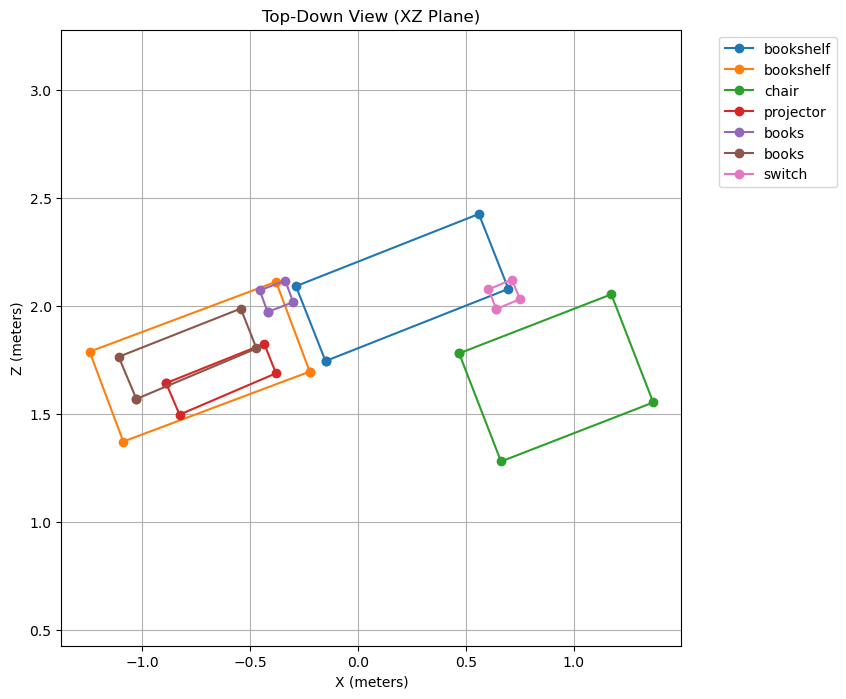

In [60]:
import matplotlib.pyplot as plt
import numpy as np

plt.figure(figsize=(8, 8))

for obj in anno["objects"]:
    if obj is None:
        continue

    poly = obj["polygon"][0]
    X = np.array(poly["X"])
    Z = np.array(poly["Z"])

    X = np.append(X, X[0])
    Z = np.append(Z, Z[0])

    plt.plot(X, Z, marker="o", label=obj["name"])

plt.xlabel("X (meters)")
plt.ylabel("Z (meters)")
plt.title("Top-Down View (XZ Plane)")
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
plt.axis("equal")
plt.grid(True)
plt.show()


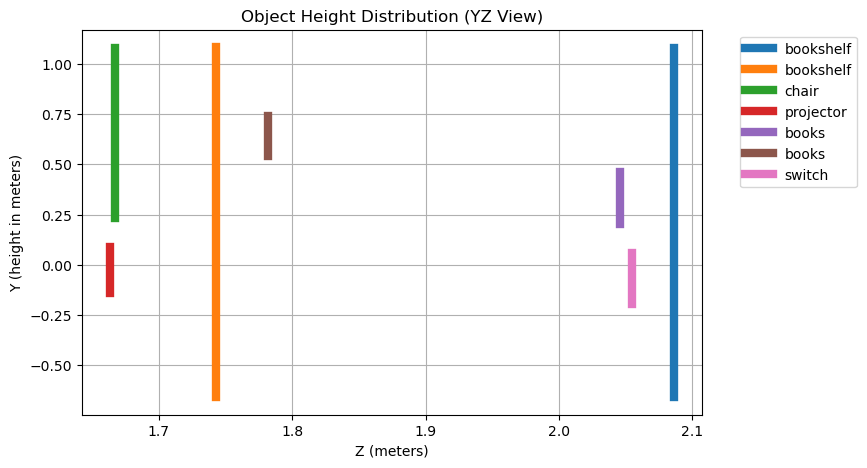

In [61]:
plt.figure(figsize=(8, 5))

for obj in anno["objects"]:
    if obj is None:
        continue

    poly = obj["polygon"][0]
    z_center = np.mean(poly["Z"])

    plt.plot(
        [z_center, z_center],
        [poly["Ymin"], poly["Ymax"]],
        linewidth=6,
        label=obj["name"]
    )

plt.xlabel("Z (meters)")
plt.ylabel("Y (height in meters)")
plt.title("Object Height Distribution (YZ View)")
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
plt.grid(True)
plt.show()


In [62]:
import plotly.graph_objects as go

fig = go.Figure()

for obj in anno["objects"]:
    if obj is None:
        continue

    poly = obj["polygon"][0]
    X = np.array(poly["X"])
    Z = np.array(poly["Z"])
    Ymin, Ymax = poly["Ymin"], poly["Ymax"]

    # close polygon
    Xc = np.append(X, X[0])
    Zc = np.append(Z, Z[0])

    # bottom
    fig.add_trace(go.Scatter3d(
        x=Xc,
        y=[Ymin]*len(Xc),
        z=Zc,
        mode="lines",
        name=obj["name"],
        line=dict(width=4)
    ))

    # top
    fig.add_trace(go.Scatter3d(
        x=Xc,
        y=[Ymax]*len(Xc),
        z=Zc,
        mode="lines",
        showlegend=False,
        line=dict(width=4)
    ))

    # vertical edges
    for x, z in zip(X, Z):
        fig.add_trace(go.Scatter3d(
            x=[x, x],
            y=[Ymin, Ymax],
            z=[z, z],
            mode="lines",
            showlegend=False
        ))

fig.update_layout(
    title="3D Annotation Visualization (Extruded Polygons)",
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Z"
    ),
    height=800
)

fig.show()


In [63]:
import os
import json
import cv2
import numpy as np
import plotly.graph_objects as go

# --------------------------------------------------
# Paths
# --------------------------------------------------
img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"
anno_path = os.path.join(img_dir, "annotation3Dfinal", "index.json")
depth_path = os.path.join(img_dir, "depth", os.listdir(os.path.join(img_dir, "depth"))[0])
K_path = os.path.join(img_dir, "intrinsics.txt")

# --------------------------------------------------
# Load data
# --------------------------------------------------
with open(anno_path, "r") as f:
    anno = json.load(f)

depth_raw = cv2.imread(depth_path, cv2.IMREAD_UNCHANGED).astype(np.float32)
K = np.loadtxt(K_path)

# --------------------------------------------------
# Depth → camera-frame point cloud (NO scaling yet)
# --------------------------------------------------
def depth_to_points(depth, K, max_points=60000):
    ys, xs = np.where(depth > 0)

    if len(xs) > max_points:
        idx = np.random.choice(len(xs), max_points, replace=False)
        xs, ys = xs[idx], ys[idx]

    Z = depth[ys, xs]
    X = (xs - K[0, 2]) * Z / K[0, 0]
    Y = (ys - K[1, 2]) * Z / K[1, 1]

    return np.stack([X, Y, Z], axis=1)

pc_raw = depth_to_points(depth_raw, K)

# --------------------------------------------------
# Estimate correct depth scale using annotation Z
# --------------------------------------------------
anno_Z = []
for obj in anno["objects"]:
    if obj is None:
        continue
    poly = obj["polygon"][0]
    anno_Z.extend(poly["Z"])

anno_Z_mean = np.mean(anno_Z)
depth_Z_mean = np.median(pc_raw[:, 2])

scale = anno_Z_mean / depth_Z_mean
print(f"Estimated depth scale factor: {scale:.4f}")

# --------------------------------------------------
# Apply scale
# --------------------------------------------------
depth_scaled = depth_raw * scale
pc = depth_to_points(depth_scaled, K)

# --------------------------------------------------
# Plot
# --------------------------------------------------
fig = go.Figure()

# Depth cloud
fig.add_trace(go.Scatter3d(
    x=pc[:, 0],
    y=pc[:, 1],
    z=pc[:, 2],
    mode="markers",
    marker=dict(size=1, opacity=0.25),
    name="Depth Point Cloud"
))

# Annotation polygons
for obj in anno["objects"]:
    if obj is None:
        continue

    poly = obj["polygon"][0]
    name = obj["name"]

    X = np.array(poly["X"])
    Z = np.array(poly["Z"])
    Ymin, Ymax = poly["Ymin"], poly["Ymax"]

    # Close loop
    Xc = np.append(X, X[0])
    Zc = np.append(Z, Z[0])

    # Bottom and top edges
    fig.add_trace(go.Scatter3d(
        x=Xc, y=[Ymin]*len(Xc), z=Zc,
        mode="lines", line=dict(width=5),
        name=name
    ))

    fig.add_trace(go.Scatter3d(
        x=Xc, y=[Ymax]*len(Xc), z=Zc,
        mode="lines", line=dict(width=5),
        showlegend=False
    ))

    # Vertical faces
    for i in range(len(X)):
        fig.add_trace(go.Mesh3d(
            x=[X[i], X[i], X[(i+1)%len(X)], X[(i+1)%len(X)]],
            y=[Ymin, Ymax, Ymax, Ymin],
            z=[Z[i], Z[i], Z[(i+1)%len(Z)], Z[(i+1)%len(Z)]],
            opacity=0.35,
            color="red",
            showlegend=False
        ))

    # Label
    fig.add_trace(go.Scatter3d(
        x=[X.mean()],
        y=[(Ymin + Ymax)/2],
        z=[Z.mean()],
        mode="text",
        text=[name],
        showlegend=False
    ))

# --------------------------------------------------
# Layout (CRITICAL)
# --------------------------------------------------
fig.update_layout(
    title="Correctly Aligned SUNRGBD Depth + Annotation3D",
    height=900,
    scene=dict(
        xaxis_title="X (m)",
        yaxis_title="Y (m)",
        zaxis_title="Z (m)",
        aspectmode="data",
        camera=dict(eye=dict(x=1.6, y=1.3, z=1.2))
    )
)

fig.show()


Estimated depth scale factor: 0.0001


## Understanding Annotation3Dlayout


TOP-LEVEL KEYS
['date', 'name', 'frames', 'objects', 'extrinsics', 'conflictList', 'fileList']

FULL STRUCTURE (TRUNCATED)
date: str
  Sat, 29 Nov 2014 21:37:19 GMT
name: str
  b3do/img_0063
frames: list
  list[1]
objects: list
  list[3]
    None
extrinsics: str
  20140915210114.txt
conflictList: list
  list[1]
    None
fileList: list
  list[1]
    img_0063.jpg

NUMBER OF FRAMES: 1

Frame[0] keys:
dict_keys([])

Frame[0] content:
{}

NUMBER OF OBJECTS: 3

Object 0:
None

Object 1:
None

Object 2:
{'name': 'room',
 'polygon': [{'X': [3.05, 2.49, 0.81, 0.73, -2.83, -2.87, -2.71, -0.01],
              'Ymax': 1.2,
              'Ymin': -0.87,
              'Z': [1.34, 2.64, 2.02, 2.46, 1.3, 1.28, 0.46, -0.02],
              'rectangle': False}]}

EXTRINSICS
20140915210114.txt

FILE LIST
['img_0063.jpg']


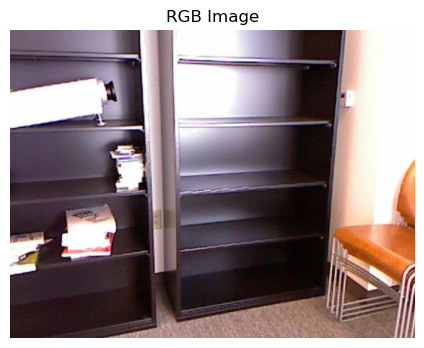

In [64]:
import os
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pprint import pprint

# ------------------------------------
# Paths
# ------------------------------------
img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"
anno_path = os.path.join(img_dir, "annotation3Dlayout", "index.json")

# ------------------------------------
# Load annotation
# ------------------------------------
with open(anno_path, "r") as f:
    anno = json.load(f)

print("\n==============================")
print("TOP-LEVEL KEYS")
print("==============================")
pprint(list(anno.keys()))

# ------------------------------------
# Utility: recursive structure dump
# ------------------------------------
def dump_structure(obj, indent=0, max_depth=4):
    prefix = "  " * indent
    if indent > max_depth:
        print(prefix + "...")
        return

    if isinstance(obj, dict):
        for k, v in obj.items():
            print(f"{prefix}{k}: {type(v).__name__}")
            dump_structure(v, indent + 1, max_depth)
    elif isinstance(obj, list):
        print(f"{prefix}list[{len(obj)}]")
        if len(obj) > 0:
            dump_structure(obj[0], indent + 1, max_depth)
    else:
        print(f"{prefix}{obj}")

print("\n==============================")
print("FULL STRUCTURE (TRUNCATED)")
print("==============================")
dump_structure(anno)

# ------------------------------------
# Inspect frames
# ------------------------------------
frames = anno.get("frames", [])
print("\n==============================")
print(f"NUMBER OF FRAMES: {len(frames)}")
print("==============================")

if len(frames) > 0:
    print("\nFrame[0] keys:")
    pprint(frames[0].keys())
    print("\nFrame[0] content:")
    pprint(frames[0])

# ------------------------------------
# Inspect objects
# ------------------------------------
objects = anno.get("objects", [])
print("\n==============================")
print(f"NUMBER OF OBJECTS: {len(objects)}")
print("==============================")

for i, obj in enumerate(objects):
    print(f"\nObject {i}:")
    pprint(obj)

# ------------------------------------
# Inspect extrinsics
# ------------------------------------
print("\n==============================")
print("EXTRINSICS")
print("==============================")
print(anno.get("extrinsics"))

# ------------------------------------
# Inspect fileList
# ------------------------------------
file_list = anno.get("fileList", [])
print("\n==============================")
print("FILE LIST")
print("==============================")
pprint(file_list)

# ------------------------------------
# Load RGB image
# ------------------------------------
img_path = os.path.join(img_dir, "image", os.listdir(os.path.join(img_dir, "image"))[0])
img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(6, 4))
plt.imshow(img)
plt.title("RGB Image")
plt.axis("off")
plt.show()


In [65]:

img_dir = "data/sunrgbd/kv1/b3dodata/img_0063"
anno_path = os.path.join(img_dir, "annotation3Dlayout", "index.json")

with open(anno_path, "r") as f:
    anno = json.load(f)

# Extract room polygon
room_obj = None
for obj in anno["objects"]:
    if obj is not None and obj.get("name") == "room":
        room_obj = obj
        break

assert room_obj is not None, "Room layout not found"

poly = room_obj["polygon"][0]

X = np.array(poly["X"])
Z = np.array(poly["Z"])
Ymin, Ymax = poly["Ymin"], poly["Ymax"]

# Close polygon
Xc = np.append(X, X[0])
Zc = np.append(Z, Z[0])


In [66]:
fig = go.Figure()

# Floor & ceiling outlines
for Y, name in [(Ymin, "Floor"), (Ymax, "Ceiling")]:
    fig.add_trace(go.Scatter3d(
        x=Xc,
        y=[Y] * len(Xc),
        z=Zc,
        mode="lines",
        line=dict(width=6),
        name=name
    ))

# Walls
for i in range(len(X)):
    fig.add_trace(go.Mesh3d(
        x=[X[i], X[i], X[(i+1)%len(X)], X[(i+1)%len(X)]],
        y=[Ymin, Ymax, Ymax, Ymin],
        z=[Z[i], Z[i], Z[(i+1)%len(Z)], Z[(i+1)%len(Z)]],
        opacity=0.35,
        color="lightblue",
        showlegend=False
    ))

fig.update_layout(
    title="Annotation3Dlayout: Room Volume",
    scene=dict(
        xaxis_title="X (m)",
        yaxis_title="Y (m)",
        zaxis_title="Z (m)",
        aspectmode="data",
        camera=dict(eye=dict(x=1.5, y=1.2, z=1.6))
    ),
    height=850
)

fig.show()


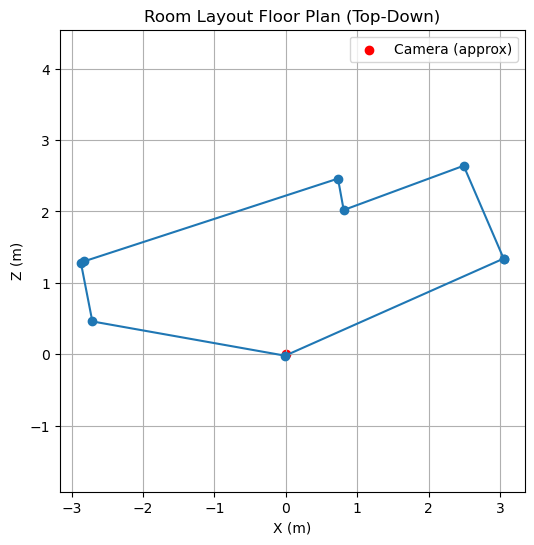

In [67]:
import matplotlib.pyplot as plt

plt.figure(figsize=(6, 6))
plt.plot(Xc, Zc, "-o")
plt.scatter(0, 0, c="red", label="Camera (approx)")
plt.xlabel("X (m)")
plt.ylabel("Z (m)")
plt.title("Room Layout Floor Plan (Top-Down)")
plt.axis("equal")
plt.grid(True)
plt.legend()
plt.show()
